# Big Mobility Data Analytics - Task

Objective: Use NY taxi trips and restaurants datasets and combine them spatially, create a visualization and perform EDA  
Date: February 20, 2023  
Author: Chirag Khatri ckhatri@usc.edu  

## Importing libraries

In [659]:
import json

from geopy import distance

import pandas as pd
import plotly.express as px
import requests

In [773]:
nyctrips_meal_rest.columns


Index(['VendorID', 'tpep_pickup_datetime', 'tpep_dropoff_datetime',
       'passenger_count', 'trip_distance', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
       'fare_amount', 'tip_amount', 'total_amount', 'duration_mins',
       'pickup_hour', 'meal', 'nearest_rest', 'nearest_rest_idx',
       'nearest_rest_dist_m', 'rest_idx_in_50m', 'CAMIS', 'DBA', 'BORO',
       'BUILDING', 'STREET', 'ZIPCODE', 'CUISINE DESCRIPTION', 'ADDRESS',
       'geo_address', 'lat', 'lng'],
      dtype='object')

## Reading data

In [660]:
nyctrips = pd.read_csv("./data/nyctripsdata.csv")
print(nyctrips.info())
nyctrips.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97986 entries, 0 to 97985
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               97986 non-null  int64  
 1   tpep_pickup_datetime   97986 non-null  object 
 2   tpep_dropoff_datetime  97986 non-null  object 
 3   passenger_count        97986 non-null  int64  
 4   trip_distance          97986 non-null  float64
 5   pickup_longitude       97986 non-null  float64
 6   pickup_latitude        97986 non-null  float64
 7   dropoff_longitude      97986 non-null  float64
 8   dropoff_latitude       97986 non-null  float64
 9   fare_amount            97986 non-null  float64
 10  tip_amount             97986 non-null  float64
 11  total_amount           97986 non-null  float64
dtypes: float64(8), int64(2), object(2)
memory usage: 9.0+ MB
None


,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,fare_amount,tip_amount,total_amount
0,2,2015-01-15 19:05:39 +00:00,2015-01-15 19:23:42 +00:00,1,1.59,-73.993896,40.750111,-73.974785,40.750618,12.0,3.25,17.05
1,2,2015-01-15 19:05:39 +00:00,2015-01-15 19:32:00 +00:00,1,2.38,-73.976425,40.739811,-73.983978,40.757889,16.5,4.38,22.68
2,2,2015-01-15 19:05:40 +00:00,2015-01-15 19:21:00 +00:00,5,2.83,-73.968704,40.754246,-73.955124,40.786858,12.5,0.00,14.30
3,2,2015-01-15 19:05:40 +00:00,2015-01-15 19:28:18 +00:00,5,8.33,-73.863060,40.769581,-73.952713,40.785782,26.0,8.08,41.21
4,2,2015-01-15 19:05:41 +00:00,2015-01-15 19:20:36 +00:00,1,2.37,-73.945541,40.779423,-73.980850,40.786083,11.5,0.00,13.30


In [661]:
nycinspections = pd.read_csv("./data/DOHMH_New_York_City_Restaurant_Inspection_Results.csv")
print(nycinspections.info())
nycinspections.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399918 entries, 0 to 399917
Data columns (total 18 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   CAMIS                  399918 non-null  int64  
 1   DBA                    399559 non-null  object 
 2   BORO                   399918 non-null  object 
 3   BUILDING               399809 non-null  object 
 4   STREET                 399909 non-null  object 
 5   ZIPCODE                399909 non-null  float64
 6   PHONE                  399913 non-null  object 
 7   CUISINE DESCRIPTION    399918 non-null  object 
 8   INSPECTION DATE        399918 non-null  object 
 9   ACTION                 398783 non-null  object 
 10  VIOLATION CODE         393414 non-null  object 
 11  VIOLATION DESCRIPTION  392939 non-null  object 
 12  CRITICAL FLAG          399918 non-null  object 
 13  SCORE                  376704 non-null  float64
 14  GRADE                  195413 non-nu

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE
0,40511702,NOTARO RESTAURANT,MANHATTAN,635,SECOND AVENUE,10016.0,2126863400,Italian,06/15/2015,Violations were cited in the following area(s).,02B,Hot food item not held at or above 140Âº F.,Critical,30.0,NaN,NaN,08/28/2017,Cycle Inspection / Initial Inspection
1,40511702,NOTARO RESTAURANT,MANHATTAN,635,SECOND AVENUE,10016.0,2126863400,Italian,11/25/2014,Violations were cited in the following area(s).,20F,Current letter grade card not posted.,Not Critical,NaN,NaN,NaN,08/28/2017,Administrative Miscellaneous / Initial Inspection
2,50046354,VITE BAR,QUEENS,2507,BROADWAY,11106.0,3478134702,Italian,10/03/2016,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,Not Critical,2.0,NaN,NaN,08/28/2017,Pre-permit (Operational) / Initial Inspection
3,50061389,TACK'S CHINESE TAKE OUT,STATEN ISLAND,11C,HOLDEN BLVD,10314.0,7189839854,Chinese,05/17/2017,Violations were cited in the following area(s).,02G,Cold food item held above 41Âº F (smoked fish ...,Critical,46.0,NaN,NaN,08/28/2017,Pre-permit (Operational) / Initial Inspection
4,41516263,NO QUARTER,BROOKLYN,8015,5 AVENUE,11209.0,7187019180,American,03/30/2017,Violations were cited in the following area(s).,04M,Live roaches present in facility's food and/or...,Critical,18.0,NaN,NaN,08/28/2017,Cycle Inspection / Initial Inspection


## Exploratory Data Analysis
### Missing values in data

In [5]:
# Proportion of missing values in columns
(nycinspections.isna().sum() / nycinspections.shape[0]) * 100

CAMIS                     0.000000
DBA                       0.089768
BORO                      0.000000
BUILDING                  0.027256
STREET                    0.002250
ZIPCODE                   0.002250
PHONE                     0.001250
CUISINE DESCRIPTION       0.000000
INSPECTION DATE           0.000000
ACTION                    0.283808
VIOLATION CODE            1.626333
VIOLATION DESCRIPTION     1.745108
CRITICAL FLAG             0.000000
SCORE                     5.804690
GRADE                    51.136733
GRADE DATE               51.785116
RECORD DATE               0.000000
INSPECTION TYPE           0.283808
dtype: float64

**Finding:**  
- More than **half** of the values in columns `Grade` and `Grade Date` contain NA, in NYC inspections data. Although `Grade` is not a useful feature for the specific task in this notebook, 50% NA values stand out.
- TODO: Consider removing rows with `Inspection Date` as 01/01/1900
- No NA values in NYC trips data

In [6]:
# Check if Inspection date is valid where Grade is NA
invalid_inspec_date = nycinspections[(nycinspections['INSPECTION DATE'] == '01/01/1900') | (nycinspections['INSPECTION DATE'].isna())]
invalid_inspec_date.groupby(['GRADE'], dropna=False).size()

GRADE
A         1
NaN    1134
dtype: int64

In [7]:
# Proportion of rows where Grade is NA and Inspection Date is invalid
(invalid_inspec_date.shape[0] / nycinspections['GRADE'].isna().sum()) * 100

0.5549986552896017

**Finding:**
- Only <1% rows with missing `Grade` have an invalid `Inspection Date`

In [8]:
# TODO: Missing values in address (building, street, zipcode)

### Working with date columns

**NYC Trips data**

In [9]:
# Fix datetime column type
# Current type
print(nyctrips['tpep_pickup_datetime'][0], type(nyctrips['tpep_pickup_datetime'][0]))

nyctrips['tpep_pickup_datetime'] = pd.to_datetime(nyctrips['tpep_pickup_datetime'])
nyctrips['tpep_dropoff_datetime'] = pd.to_datetime(nyctrips['tpep_dropoff_datetime'])

# Date column type after conversion
print(nyctrips['tpep_pickup_datetime'][0], type(nyctrips['tpep_pickup_datetime'][0]))

2015-01-15 19:05:39 +00:00 <class 'str'>
2015-01-15 19:05:39+00:00 <class 'pandas._libs.tslibs.timestamps.Timestamp'>


In [10]:
# First and Last dates
print("NYC TRIPS \nFirst PICKUP: {} \nLast PICKUP: {} \nFirst DROPOFF: {} \nLast DROPOFF: {} ".format(min(nyctrips['tpep_pickup_datetime']),
                                                                                                     max(nyctrips['tpep_pickup_datetime']),
                                                                                                     min(nyctrips['tpep_dropoff_datetime']),
                                                                                                     max(nyctrips['tpep_dropoff_datetime']),
                                                                                                    ))

NYC TRIPS 
First PICKUP: 2015-01-15 00:01:32+00:00 
Last PICKUP: 2015-01-15 23:59:59+00:00 
First DROPOFF: 2015-01-15 00:02:31+00:00 
Last DROPOFF: 2015-01-16 23:41:21+00:00 


**NYC Inspections data**

In [11]:
# Fix datetime column type
# Current type
print(nycinspections['INSPECTION DATE'][0], type(nycinspections['INSPECTION DATE'][0]))

nycinspections['INSPECTION DATE'] = pd.to_datetime(nycinspections['INSPECTION DATE'])

# Date column type after conversion
print(nycinspections['INSPECTION DATE'][0], type(nycinspections['INSPECTION DATE'][0]))

06/15/2015 <class 'str'>
2015-06-15 00:00:00 <class 'pandas._libs.tslibs.timestamps.Timestamp'>


In [12]:
# First and Last dates
print("NYC INSPECTIONS \nFirst Inspection: {} \nLast Inspection: {}".format(min(nycinspections['INSPECTION DATE']), max(nycinspections['INSPECTION DATE']),))

NYC INSPECTIONS 
First Inspection: 1900-01-01 00:00:00 
Last Inspection: 2017-08-26 00:00:00


### Univariate Analysis

**NYC Trips data**

In [52]:
# Percentile distribution of passenger_count
nyctrips['passenger_count'].quantile([0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.25    1.0
0.50    1.0
0.75    2.0
0.90    4.0
0.95    5.0
0.99    6.0
Name: passenger_count, dtype: float64

In [55]:
# Proportion of taxi rides with a single passenger
(nyctrips[nyctrips['passenger_count']==1].shape[0] / nyctrips['passenger_count'].shape[0]) * 100

72.38278937807442

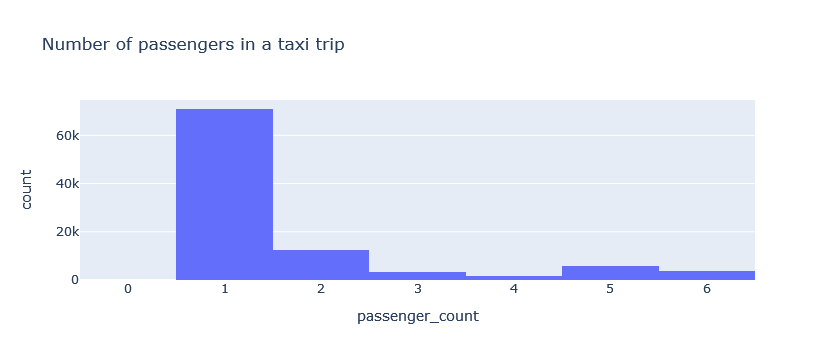

In [44]:
fig = px.histogram(nyctrips, x='passenger_count', title="Number of passengers in a taxi trip")
fig.show()

In [32]:
# Percentile distribution of trip_distance (in miles)
nyctrips['trip_distance'].quantile([0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.05     0.5000
0.10     0.6500
0.25     1.0000
0.50     1.6700
0.75     3.0700
0.90     6.3000
0.95    10.0000
0.99    18.1715
Name: trip_distance, dtype: float64

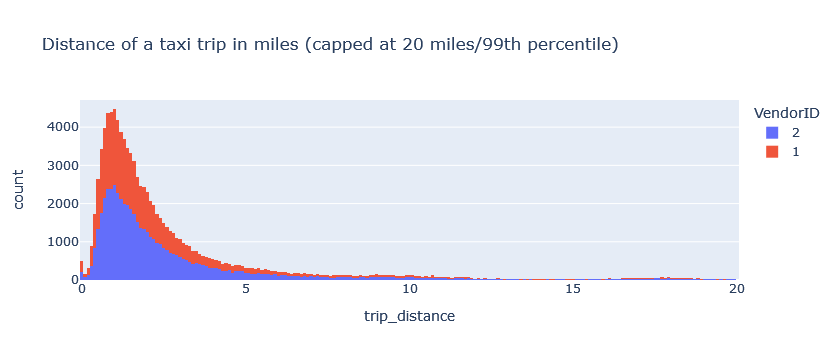

In [48]:
fig = px.histogram(nyctrips[nyctrips['trip_distance']<20],
                   x='trip_distance',
                   color='VendorID',
                   title="Distance of a taxi trip in miles (capped at 20 miles/99th percentile)")
fig.show()

In [31]:
# Percentile distribution of total_amount (in USD)
nyctrips['total_amount'].quantile([0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.05     5.80
0.10     6.80
0.25     8.30
0.50    11.60
0.75    17.15
0.90    27.80
0.95    42.15
0.99    69.60
Name: total_amount, dtype: float64

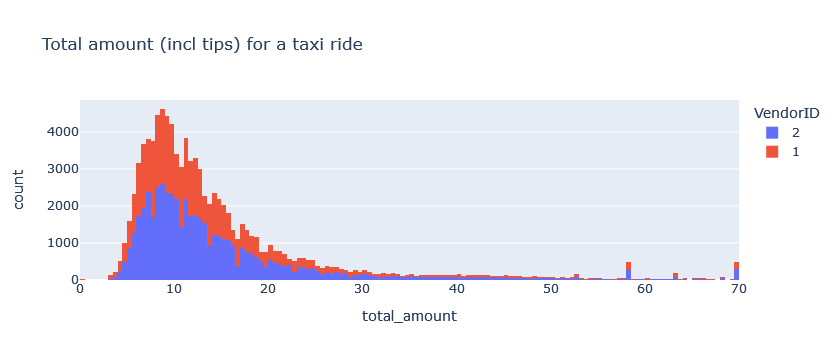

In [49]:
fig = px.histogram(nyctrips[(nyctrips['total_amount'] < 70) & (nyctrips['total_amount'] > 0)],
                   x='total_amount',
                   color='VendorID',
                   title="Total amount (incl tips) for a taxi ride")
fig.show()

In [58]:
# trip duration
nyctrips['duration_mins'] = (nyctrips['tpep_dropoff_datetime'] - nyctrips['tpep_pickup_datetime']).astype('timedelta64[m]')
nyctrips['duration_mins'].quantile([0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.05     3.0
0.10     4.0
0.25     6.0
0.50    10.0
0.75    16.0
0.90    25.0
0.95    32.0
0.99    55.0
Name: duration_mins, dtype: float64

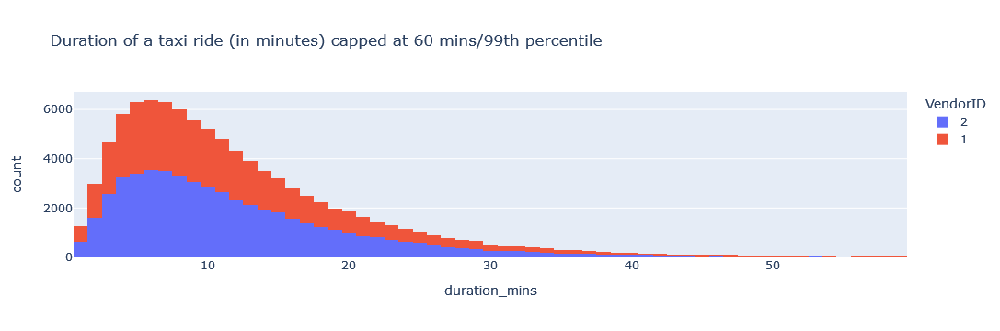

In [66]:
fig = px.histogram(nyctrips[(nyctrips['duration_mins'] < 60) & (nyctrips['duration_mins'] > 0)],
                   x='duration_mins',
                   color='VendorID',
                   title="Duration of a taxi ride (in minutes) capped at 60 mins/99th percentile")
fig.show()

In [69]:
# busy pickup times during the day
nyctrips['pickup_hour'] = nyctrips['tpep_pickup_datetime'].dt.hour
nyctrips['pickup_hour'].quantile([0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 0.95, 0.99])

0.05     1.0
0.10     6.0
0.25     9.0
0.50    15.0
0.75    20.0
0.90    22.0
0.95    23.0
0.99    23.0
Name: pickup_hour, dtype: float64

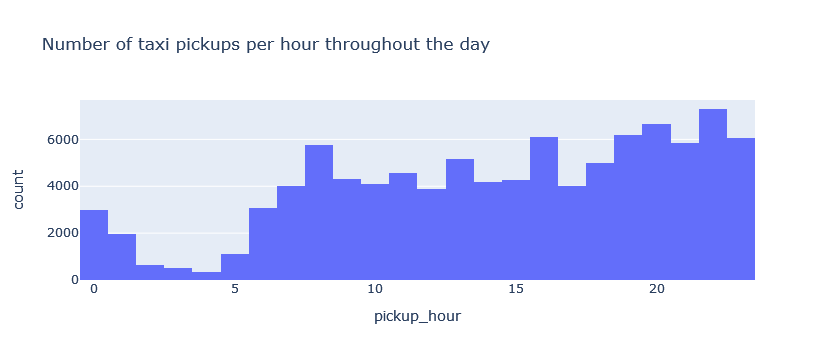

In [74]:
fig = px.histogram(nyctrips,
                   x='pickup_hour',
                   title="Number of taxi pickups per hour throughout the day")
fig.show()

**Findings:**
- Majority of taxi trips (72%) have only 1 passenger. Only about 10% of taxi trips have 4 or more passengers
- 25% of the taxi trips cover a distance of 1 mile or less. 75% cover 3 miles or less. Only about 10% are longer than 10 miles  
- About half of the taxi trips last 10 minutes or less. Only about 10% of the total trips are longer than 25 minutes  
- Evening hours (7 pm to midnight) are the busiest for taxi pickups, with 10-11 pm being the busiest with ~7.3K pickups. During daytime, 8 am and 4 pm see a considerable rush of taxi trip pickups
- There is no difference in the patterns between the two vendors in the data (seen in blue and red in the above graphs)

**NYC Inspections**

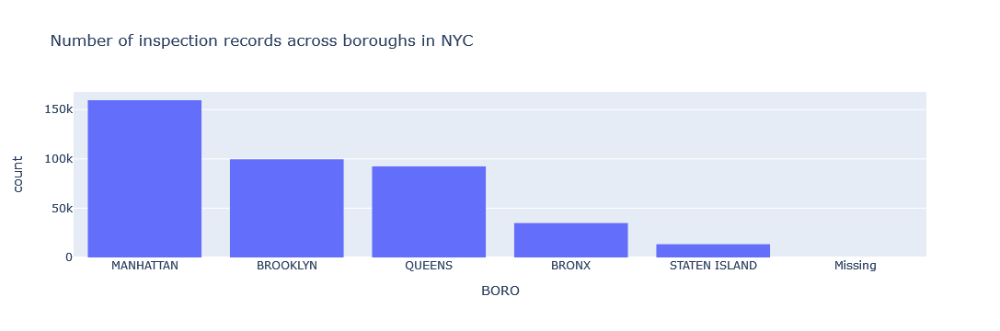

In [84]:
fig = px.histogram(nycinspections,
                   x='BORO',
                   title="Number of inspection records across boroughs in NYC",).update_xaxes(categoryorder='total descending')
fig.show()

In [93]:
count_of_restaurants = nycinspections.groupby(['BORO']).agg({'CAMIS': 'nunique'}).reset_index().sort_values('CAMIS', ascending=False)
# total number of restaurants
count_of_restaurants['CAMIS'].sum()

26505

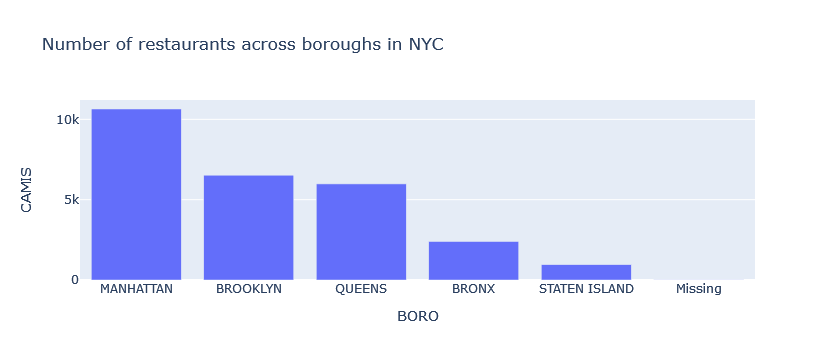

In [90]:
fig = px.bar(count_of_restaurants,
             x='BORO',
             y='CAMIS',
             title="Number of restaurants across boroughs in NYC",)
fig.show()

**Findings:**
- Manhattan has the most number of restaurants (>40% of the total 26.5K restaurants in the NYC Inspections data), followed by Brooklyn and Queens. The number of inspection records follow the same order

## Linking datasets spatially

### Geocoding restaurant addresses
Geocode restaurant addresses to get their lat, lng coordinates using Google Maps API

In [303]:
# Get lat, lng coordinates for restaurant addresses using Google Geocoding API

def geocode_address(inp_address, api_key):
    """
    Converts the address string to lat, long coordinates, given API key for google cloud
    """
    geocode_url = "https://maps.googleapis.com/maps/api/geocode/json"

    # address = building + street + zip
    url_encoded_address = inp_address
    # url_encoded_address = requests.utils.quote(inp_address)
    
    payload = {'address': url_encoded_address,
               'key': api_key,
               'region': 'US'}

    r = requests.get(geocode_url, params=payload)
    # print(r.url)
    
    if r.status_code == 200:
        # print(response.text)
        r_json = r.json()
        address_str = r_json['results'][0]['formatted_address']
        address_lat_lng = r_json['results'][0]['geometry']['location']
        return address_str, address_lat_lng

# read API key
with open("./secret/gcloud_maps_api_key.txt") as api_file:
    api_key = api_file.read()

# address_str, address_lat_lng = geocode_address('635 second avenue 10016', api_key)
# print(address_str, address_lat_lng)

In [305]:
# get unique restaurants
nyc_restaurants = nycinspections[['CAMIS', 'DBA', 'BORO', 'BUILDING', 'STREET', 'ZIPCODE', 'CUISINE DESCRIPTION']].drop_duplicates(ignore_index=True)
print(nyc_restaurants.shape)

# drop restaurants with NA addresses
nyc_restaurants.dropna(axis=0, subset=['BUILDING', 'STREET', 'ZIPCODE'], inplace=True)
print(nyc_restaurants.shape)

(26505, 7)
(26485, 7)


In [306]:
# create an address column with 'NY' string added for a more accurate Geocoding
nyc_restaurants['ADDRESS'] = nyc_restaurants['BUILDING'] + ' ' + nyc_restaurants['STREET'] + ' NY ' + nyc_restaurants['ZIPCODE'].astype('int').astype('str')

In [321]:
# Run geocoding for all restaurants - 26.5K  sequential requests to Geocoding API
# nyc_restaurants['address_lat_lng'] = nyc_restaurants.apply(lambda row: geocode_address(row['ADDRESS'], api_key), axis=1)

In [322]:
# save geocoding results
# nyc_restaurants.to_csv("./nyc_restaurants_lat_lng_geocoding_result.csv", index=False)
nyc_restaurants = pd.read_csv("./nyc_restaurants_lat_lng_geocoding_result.csv")

In [311]:
nyc_restaurants['geo_address'] = nyc_restaurants.apply(lambda row: row['address_lat_lng'][0], axis=1)
nyc_restaurants['lat'] = nyc_restaurants.apply(lambda row: row['address_lat_lng'][1]['lat'], axis=1)
nyc_restaurants['lng'] = nyc_restaurants.apply(lambda row: row['address_lat_lng'][1]['lng'], axis=1)

# remove redundant column
nyc_restaurants = nyc_restaurants.drop("address_lat_lng", axis=1)

In [319]:
nyc_restaurants[:3] # lat and lng columns

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,CUISINE DESCRIPTION,ADDRESS,geo_address,lat,lng
0,40511702,NOTARO RESTAURANT,MANHATTAN,635,SECOND AVENUE,10016.0,Italian,635 SECOND AVENUE NY 10016,"635 2nd Ave, New York, NY 10016, USA",40.745295,-73.975777
1,50046354,VITE BAR,QUEENS,2507,BROADWAY,11106.0,Italian,2507 BROADWAY NY 11106,"2507 Broadway, New York, NY 10025, USA",40.793126,-73.973306
2,50061389,TACK'S CHINESE TAKE OUT,STATEN ISLAND,11C,HOLDEN BLVD,10314.0,Chinese,11C HOLDEN BLVD NY 10314,"11 Holden Blvd, Staten Island, NY 10314, USA",40.604667,-74.121197


**Add Lunch/Dinner labels**

Add lunchtime (11.30 am to 2 pm), dinnertime (5 pm to 9 pm) labels to NYC Trips data based on **dropoff** times. An assumption is made to choose dropoff times instead of pickup times, because trips end at the restaurant at the dropoff time

In [361]:
# Add lunchtime (11.30 am to 2 pm), dinnertime (5 pm to 9 pm) labels to NYC Trips data based on dropoff times
lunch_start, lunch_end = "11:30:00", "14:00:00"
dinner_start, dinner_end = "17:00:00", "21:00:00"

# convert to datetime.time format
lunch_start, lunch_end, dinner_start, dinner_end = map(lambda x: pd.to_datetime(x, format='%H:%M:%S').time(), [lunch_start, lunch_end, dinner_start, dinner_end])

lunchtime = (nyctrips['tpep_dropoff_datetime'].dt.time >= lunch_start) & (nyctrips['tpep_dropoff_datetime'].dt.time <= lunch_end)
dinnertime = (nyctrips['tpep_dropoff_datetime'].dt.time >= dinner_start) & (nyctrips['tpep_dropoff_datetime'].dt.time <= dinner_end)

nyctrips.loc[lunchtime == True, 'meal'] = 'lunchtime'
nyctrips.loc[dinnertime == True, 'meal'] = 'dinnertime'

In [369]:
nyctrips[:3] # lunchtime and dinnertime labels in 'meal' column

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,fare_amount,tip_amount,total_amount,duration_mins,pickup_hour,meal
0,2,2015-01-15 19:05:39+00:00,2015-01-15 19:23:42+00:00,1,1.59,-73.993896,40.750111,-73.974785,40.750618,12.0,3.25,17.05,18.0,19,dinnertime
1,2,2015-01-15 19:05:39+00:00,2015-01-15 19:32:00+00:00,1,2.38,-73.976425,40.739811,-73.983978,40.757889,16.5,4.38,22.68,26.0,19,dinnertime
2,2,2015-01-15 19:05:40+00:00,2015-01-15 19:21:00+00:00,5,2.83,-73.968704,40.754246,-73.955124,40.786858,12.5,0.00,14.30,15.0,19,dinnertime


### Distance between two (lat, lng) points

Two commonly used methods of measuring distances between two coordinate points on the Earth are using:
- [Great Circle distance](https://en.wikipedia.org/wiki/Great-circle_distance): Assumes Earth is a sphere with a radius of approx 6371 km. This is fast to compute but is less accurate.
- **Geodesic** distance: Assumes Earth to be ellipsoidal and gives more accurate results than Great Circle distance, but is slower to compute. [Karney (2013)](https://doi.org/10.1007%2Fs00190-012-0578-z).

The package [geopy](https://geopy.readthedocs.io/en/stable/#module-geopy.distance) provides implementations of both methods of computing distances

In [377]:
newport_ri = (41.49008, -71.312796)
cleveland_oh = (41.499498, -81.695391)

print(distance.distance(newport_ri, cleveland_oh).m) # distance in metres

866455.4329098687


In [ ]:
# Finding the nearest restaurant for each Lunch, Dinner trip

In [502]:
# Subset of lunch and dinner taxi trips
nyctrips_meal = nyctrips[nyctrips['meal'].isna() == False]
nyctrips_meal.shape

(33479, 15)

In [503]:
nyc_restaurants.reset_index(drop=True, inplace=True)
nyctrips_meal.reset_index(drop=True, inplace=True)

In [517]:
nyctrips_meal.iloc[0]['dropoff_latitude'], nyctrips_meal.iloc[0]['dropoff_longitude']

(40.75061798, -73.97478485)

In [530]:
%%time
def get_nearest_restaurant(lat, lng):
    """
    Returns the nearest restaurant (within a radius of 50m) from the NYC Inspections data, to the given (lat, lng) point.
    Geodesic distance is measured in metres using geopy.distance
    """
    print("Comparing lat {}, lng {} with all restaurants".format(lat, lng))
    trip_restaurant_distances = pd.Series(distance.great_circle((lat, lng), (r_lat, r_lng)).m for (r_lat, r_lng) in zip(nyc_restaurants['lat'], nyc_restaurants['lng'])) 
    # print(trip_restaurant_distances)
    min_restaurant_distance_idx = trip_restaurant_distances.argmin()
    min_restaurant_distance = trip_restaurant_distances[min_restaurant_distance_idx]
    # print(trip_restaurant_distances)
    return min_restaurant_distance_idx, min_restaurant_distance

# nyctrips_meal['nearest_rest'] = nyctrips_meal.apply(lambda row: get_nearest_restaurant(row['dropoff_latitude'], row['dropoff_longitude']), axis=1)

## split restaurant info column into two separate columns
# nyctrips_meal['nearest_rest_idx'] = nyctrips_meal.apply(lambda row: row['nearest_rest'][0], axis=1) 
# nyctrips_meal['nearest_rest_dist_m'] = nyctrips_meal.apply(lambda row: row['nearest_rest'][1], axis=1)

Comparing lat 40.75061798, lng -73.97478485 with all restaurants
Comparing lat 40.75788879, lng -73.98397827 with all restaurants
Comparing lat 40.7868576, lng -73.9551239 with all restaurants
Comparing lat 40.78578186, lng -73.95271301 with all restaurants
Comparing lat 40.78608322, lng -73.98085022 with all restaurants
Comparing lat 40.71858978, lng -73.95237732 with all restaurants
Comparing lat 40.71459579, lng -73.99892426 with all restaurants
Comparing lat 40.73464966, lng -73.99993896 with all restaurants
Comparing lat 40.73551178, lng -74.00356293 with all restaurants
Comparing lat 40.70421982, lng -74.00791931 with all restaurants
Comparing lat 40.76185608, lng -73.9781723 with all restaurants
Comparing lat 40.81108856, lng -73.95333862 with all restaurants
Comparing lat 40.73488998, lng -73.98860931 with all restaurants
Comparing lat 40.74353027, lng -73.98560333 with all restaurants
Comparing lat 40.75772095, lng -73.99451447 with all restaurants
Comparing lat 40.70468903, l

<timed exec>:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [535]:
# nyctrips_meal.to_csv("./nyc_trips_nearest_restaurant_result.csv", index=False)

In [615]:
nyctrips_meal = pd.read_csv("./nyc_trips_nearest_restaurant_result.csv")

In [616]:
rest_in_50_m = nyctrips_meal['nearest_rest_dist_m'] < 51
nyctrips_meal.loc[rest_in_50_m == True, 'rest_idx_in_50m'] = nyctrips_meal['nearest_rest_idx']

In [617]:
# Proportion of trips during meal times (lunch or dinner) that were not to a nearby restaurant (within 50m)
(nyctrips_meal['rest_idx_in_50m'].isna().sum() / nyctrips_meal.shape[0]) * 100

28.53430508677081

In [618]:
# Most frequently visited restaurants
nyctrips_meal.groupby('rest_idx_in_50m').agg({'nearest_rest': 'count'}).reset_index().sort_values('nearest_rest', ascending=False)

,rest_idx_in_50m,nearest_rest
3405,12661.0,79
5218,20542.0,70
1532,5230.0,66
3412,12693.0,53
3863,14450.0,46
...,...,...
1561,5336.0,1
4680,18048.0,1
794,2679.0,1
3067,11273.0,1


**Findings:**
- About 30% of trips during mealtime (lunch or dinner) had no nearby restaurants within 50 metres of their taxi dropoff point
- These trips would be removed in the subsequent analysis


In [638]:
# remove tripts without a nearby restaunt
nyctrips_meal.dropna(subset=['rest_idx_in_50m'], axis=0, inplace=True)

# drop trips with negative fare
nyctrips_meal = nyctrips_meal[nyctrips_meal['fare_amount']>0]

nyctrips_meal = nyctrips_meal.reset_index(drop=True)
# nyctrips_meal.info()

In [639]:
nyctrips_meal[:2]

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,fare_amount,tip_amount,total_amount,duration_mins,pickup_hour,meal,nearest_rest,nearest_rest_idx,nearest_rest_dist_m,rest_idx_in_50m
0,2,2015-01-15 19:05:39+00:00,2015-01-15 19:32:00+00:00,1,2.38,-73.976425,40.739811,-73.983978,40.757889,16.5,4.38,22.68,26,19,dinnertime,"(11866, 2.631334813536103)",11866,2.631335,11866.0
1,2,2015-01-15 19:05:41+00:00,2015-01-15 19:20:22+00:00,2,7.13,-73.874458,40.774010,-73.952377,40.718590,21.5,4.50,27.80,14,19,dinnertime,"(10855, 46.96017724326131)",10855,46.960177,10855.0


In [640]:
nyc_restaurants[:2]

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,CUISINE DESCRIPTION,ADDRESS,geo_address,lat,lng
0,40511702,NOTARO RESTAURANT,MANHATTAN,635,SECOND AVENUE,10016.0,Italian,635 SECOND AVENUE NY 10016,"635 2nd Ave, New York, NY 10016, USA",40.745295,-73.975777
1,50046354,VITE BAR,QUEENS,2507,BROADWAY,11106.0,Italian,2507 BROADWAY NY 11106,"2507 Broadway, New York, NY 10025, USA",40.793126,-73.973306


### Merged dataset - Trips with nearby restaurant

In [641]:
# get restaurant details
nyctrips_meal_rest = pd.merge(nyctrips_meal, nyc_restaurants, how='left', left_on=['rest_idx_in_50m'], right_index=True, validate='m:1')

In [642]:
print(nyctrips_meal_rest.info())
nyctrips_meal_rest.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23917 entries, 0 to 23916
Data columns (total 30 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               23917 non-null  int64  
 1   tpep_pickup_datetime   23917 non-null  object 
 2   tpep_dropoff_datetime  23917 non-null  object 
 3   passenger_count        23917 non-null  int64  
 4   trip_distance          23917 non-null  float64
 5   pickup_longitude       23917 non-null  float64
 6   pickup_latitude        23917 non-null  float64
 7   dropoff_longitude      23917 non-null  float64
 8   dropoff_latitude       23917 non-null  float64
 9   fare_amount            23917 non-null  float64
 10  tip_amount             23917 non-null  float64
 11  total_amount           23917 non-null  float64
 12  duration_mins          23917 non-null  int64  
 13  pickup_hour            23917 non-null  int64  
 14  meal                   23917 non-null  object 
 15  ne

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,fare_amount,...,DBA,BORO,BUILDING,STREET,ZIPCODE,CUISINE DESCRIPTION,ADDRESS,geo_address,lat,lng
0,2,2015-01-15 19:05:39+00:00,2015-01-15 19:32:00+00:00,1,2.38,-73.976425,40.739811,-73.983978,40.757889,16.5,...,MARGON RESTAURANT,MANHATTAN,136,WEST 46 STREET,10036.0,"Latin (Cuban, Dominican, Puerto Rican, South &...",136 WEST 46 STREET NY 10036,"136 W 46th St, New York, NY 10036, USA",40.757872,-73.984000
1,2,2015-01-15 19:05:41+00:00,2015-01-15 19:20:22+00:00,2,7.13,-73.874458,40.774010,-73.952377,40.718590,21.5,...,OVER THE EIGHT,BROOKLYN,594,UNION AVENUE,11211.0,American,594 UNION AVENUE NY 11211,"594 Union Ave, Brooklyn, NY 11211, USA",40.718238,-73.952069
2,2,2015-01-15 19:05:41+00:00,2015-01-15 19:31:00+00:00,1,3.60,-73.976601,40.751896,-73.998924,40.714596,17.5,...,SHANGHAI ASIAN MANOR,MANHATTAN,21,MOTT STREET,10013.0,Chinese,21 MOTT STREET NY 10013,"21 Mott St, New York, NY 10013, USA",40.714407,-73.999033
3,2,2015-01-15 19:05:41+00:00,2015-01-15 19:10:22+00:00,1,0.89,-73.994957,40.745079,-73.999939,40.734650,5.5,...,QUALITY EATS,MANHATTAN,19,GREENWICH AVE,10014.0,American,19 GREENWICH AVE NY 10014,"19 Greenwich Ave, New York, NY 10014, USA",40.734502,-74.000055
4,2,2015-01-15 19:05:41+00:00,2015-01-15 19:10:55+00:00,1,0.96,-74.000938,40.747063,-74.003563,40.735512,5.5,...,SANT AMBROEUS,MANHATTAN,259,WEST 4 STREET,10014.0,Italian,259 WEST 4 STREET NY 10014,"259 West 4th Street, New York, NY 10014, USA",40.735426,-74.003141


## Visualization

In [671]:
px.set_mapbox_access_token(open("./secret/mapbox_token.txt").read())

In [779]:
fig = px.scatter_mapbox(nyctrips_meal_rest,
                        lat="dropoff_latitude", lon="dropoff_longitude",
                        color="pickup_hour",
                        # mapbox_style='open-street-map',
                        size='trip_distance',
                        # mapbox_style='stamen-terrain',
                        color_continuous_scale=px.colors.cyclical.IceFire,
                        hover_data=['trip_distance', 'passenger_count', 'fare_amount', 'BORO', 'DBA', 'CUISINE DESCRIPTION'],
                        height=400, zoom=10)

fig.update_layout(margin={"r":5,"t":5,"l":5,"b":5})
fig.show()

Interactive scatterplot visualization showing taxi trips to restaurants in New York during lunch and dinner time
- Size of the bubble indicates **trip distance in miles**
- Color of the bubble indicates the **hour of the day (24-hr format)** when the passenger was picked up by the taxi
- Taxi Trip data sourced from [NYC TLC](https://www.nyc.gov/site/tlc/about/tlc-trip-record-data.page)
- Restaurant Info data sourced from [NYC Open Data](https://data.cityofnewyork.us/Health/DOHMH-New-York-City-Restaurant-Inspection-Results/43nn-pn8j)

## EDA Questions

### Trip Distance
> a. How far do people travel based on different types of cuisine (“CUISINE DESCRIPTION”)? How
does this differ based on the borough where the restaurant is located (“BORO”, one of 5 large
NYC neighborhoods)? How does this differ by meal time?

In [710]:
pd.set_option('display.max_rows', 500)

In [718]:
# Travel times by one variable
nyctrips_meal_rest.groupby(['CUISINE DESCRIPTION']).agg({'trip_distance': ['mean', 'median', 'std', 'min', 'max', 'count']})

trip_distance          \
                                                            mean  median   
CUISINE DESCRIPTION                                                        
Afghan                                                  2.385000   2.385   
African                                                 2.666667   1.700   
American                                                2.429653   1.500   
Armenian                                                2.581429   1.760   
Asian                                                   2.701055   1.690   
Australian                                              2.270000   1.430   
Bagels/Pretzels                                         2.298516   1.500   
Bakery                                                  2.260299   1.400   
Bangladeshi                                             3.245000   1.785   
Barbecue                                                2.184722   1.290   
Bottled beverages, including water, sodas, juic...      1.757931   1.200   
Brazilian                                               2.263462   1.895   
CafÃ©/Coffee/Tea                                        2.350138   1.430   
Cajun                                                   0.650000   0.650   
Californian                                             0.812500   0.880   
Caribbean                                               4.323889   3.900   
Chicken                                                 2.709403   1.775   
Chilean                                                 2.525000   2.085   
Chinese                                                 2.464896   1.595   
Chinese/Cuban                                           1.767419   1.450   
Chinese/Japanese                                        2.232157   1.700   
Continental                                             2.283390   1.350   
Creole                                                 14.445000  14.445   
Delicatessen                                            2.342610   1.420   
Donuts                                                  2.216626   1.510   
Eastern European                                        2.656410   1.470   
Egyptian                                                3.156667   1.150   
English                                                 2.161515   1.510   
Ethiopian                                               2.830556   2.600   
Filipino                                                3.566667   1.945   
French                                                  2.037975   1.350   
German                                                  2.466531   1.860   
Greek                                                   2.217661   1.500   
Hamburgers                                              2.171037   1.600   
Hawaiian                                                2.387500   1.945   
Hotdogs                                                 1.846047   1.600   
Hotdogs/Pretzels                                        2.249167   1.395   
Ice Cream, Gelato, Yogurt, Ices                         2.016991   1.400   
Indian                                                  2.287871   1.420   
Indonesian                                              2.346000   1.750   
Iranian                                                 1.290000   1.290   
Irish                                                   1.992092   1.340   
Italian                                                 2.222564   1.400   
Japanese                                                2.194248   1.490   
Jewish/Kosher                                           2.338398   1.600   
Juice, Smoothies, Fruit Salads                          2.150811   1.500   
Korean                                                  2.650000   1.430   
Latin (Cuban, Dominican, Puerto Rican, South & ...      2.585144   1.690   
Mediterranean                                           1.925054   1.400   
Mexican                                                 2.506058   1.500   
Middle Eastern         

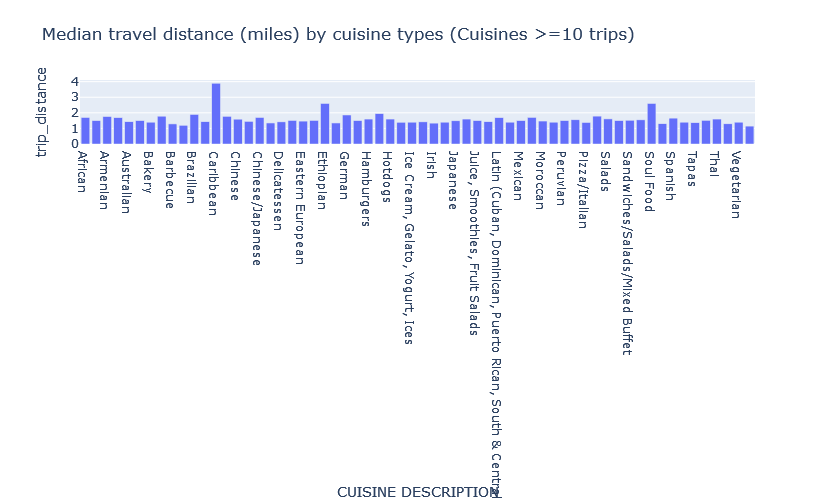

In [761]:
# plotting median trip_distance for all cuisines
eda_traveltime_cuisine = nyctrips_meal_rest.groupby(['CUISINE DESCRIPTION']).agg({'trip_distance': 'median', 'passenger_count': 'count'}).reset_index()
px.bar(eda_traveltime_cuisine[eda_traveltime_cuisine['passenger_count']>=10], x='CUISINE DESCRIPTION', y='trip_distance',
      title='Median travel distance (miles) by cuisine types (Cuisines >=10 trips)',
      height=500)

In [757]:
# plotting median trip_distance for all cuisines
"{} out of the total {} cuisine types, or about {}% cuisine types, have a median taxi trip distance under 2 miles".format((eda_traveltime_cuisine['trip_distance']<=2).sum(), eda_traveltime_cuisine.shape[0], round((eda_traveltime_cuisine['trip_distance']<=2).sum()/eda_traveltime_cuisine.shape[0] * 100),0)

'69 out of the total 78 cuisine types, or about 88% cuisine types, have a median taxi trip distance under 2 miles'

In [724]:
# Travel times by borough
nyctrips_meal_rest.groupby(['BORO']).agg({'trip_distance': ['mean', 'median', 'std', 'min', 'max', 'count']})

trip_distance                                    
                   mean median       std  min    max  count
BORO                                                       
BRONX         10.529565  11.10  5.697970  1.1  20.80     23
BROOKLYN       5.215671   4.18  4.104402  0.0  23.58    663
MANHATTAN      2.165895   1.41  2.608664  0.0  33.30  22770
QUEENS         6.676768   6.10  4.494873  0.0  24.79    461

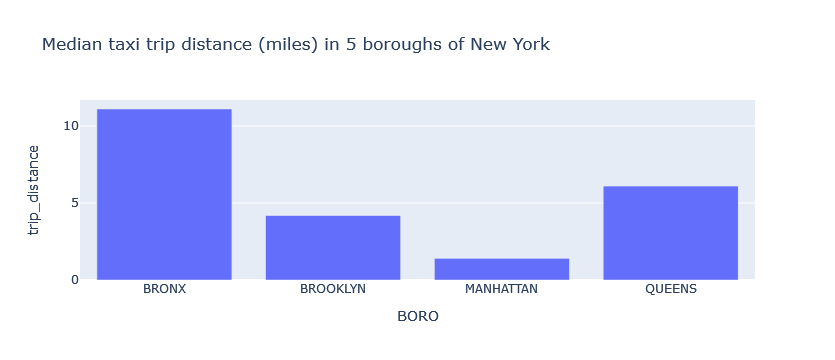

In [730]:
# plotting median trip_distance for all boroughs
eda_traveltime_boro = nyctrips_meal_rest.groupby(['BORO']).agg({'trip_distance': 'median'}).reset_index()
px.bar(eda_traveltime_boro, x='BORO', y='trip_distance',
      title='Median taxi trip distance (miles) in 5 boroughs of New York')

In [731]:
# Travel time by meal
nyctrips_meal_rest.groupby(['meal']).agg({'trip_distance': ['mean', 'median', 'std', 'min', 'max', 'count']})

trip_distance                                   
                    mean median       std  min   max  count
meal                                                       
dinnertime      2.441954    1.5  2.985325  0.0  33.3  15642
lunchtime       2.162967    1.4  2.523152  0.0  23.4   8275

**Summary:**  
Looking at the various descriptive statistics for trip_distance, we observe that:
- Most cuisine types (88% of the total 78 types) see a median trip distance of under 2 miles 
- People travel the farthest for the following cuisines: **Caribbean** (3.9 miles), **Ethiopian** (2.6 miles) and **Soul Food** (2.6 miles)
- **Bronx** has the highest median travel distance (11 miles) across the 5 boroughs, with the least number of trips 23. Manhattan has the most trips, about 23K, with the least median travel distance (1.4 miles)
- Travel distances at **dinner** times are slightly longer than **lunch** times, median distances of 1.5 miles vs 1.4 miles for dinner and lunch, respectively


### Tipping Rate

> b. What is the average tipping rate for different types of cuisine? How does this differ by borough,
by meal time, and by number of passengers in the taxi?

In [765]:
nyctrips_meal_rest.groupby(['CUISINE DESCRIPTION']).agg({'tip_amount': 'mean'}).reset_index()

,CUISINE DESCRIPTION,tip_amount
0,Afghan,2.750000
1,African,1.514815
2,American,1.618282
3,Armenian,1.599286
4,Asian,1.658794
5,Australian,0.709091
6,Bagels/Pretzels,1.701419
7,Bakery,1.384401
8,Bangladeshi,2.427000
9,Barbecue,1.564167


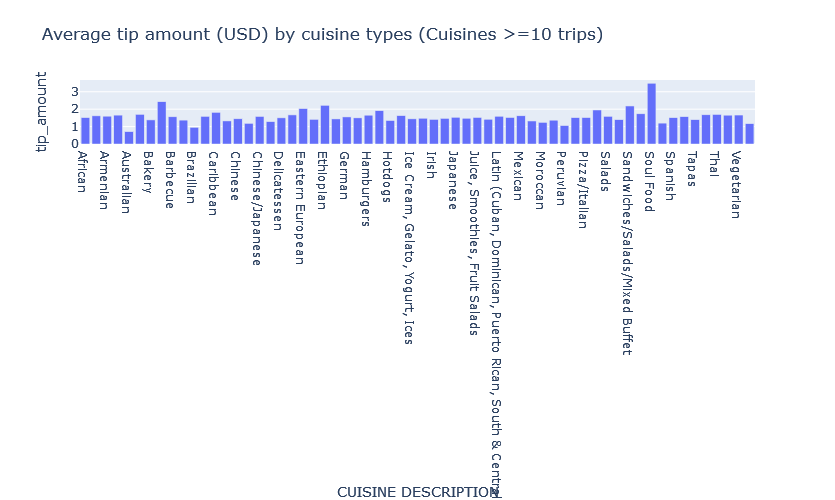

In [768]:
eda_tip_cuisine = nyctrips_meal_rest.groupby(['CUISINE DESCRIPTION']).agg({'tip_amount': 'mean', 'passenger_count': 'count'}).reset_index()
px.bar(eda_tip_cuisine[eda_tip_cuisine['passenger_count']>=10], x='CUISINE DESCRIPTION', y='tip_amount',
      title='Average tip amount (USD) by cuisine types (Cuisines >=10 trips)',
      height=500)

In [767]:
nyctrips_meal_rest.groupby(['BORO']).agg({'tip_amount': 'mean'}).reset_index()

,BORO,tip_amount
0,BRONX,2.731304
1,BROOKLYN,2.707526
2,MANHATTAN,1.489329
3,QUEENS,3.675944


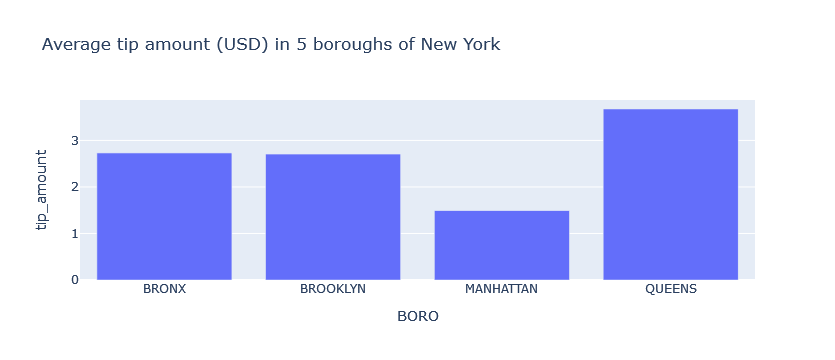

In [769]:
eda_traveltime_boro = nyctrips_meal_rest.groupby(['BORO']).agg({'tip_amount': 'mean'}).reset_index()
px.bar(eda_traveltime_boro, x='BORO', y='tip_amount',
      title='Average tip amount (USD) in 5 boroughs of New York')

In [770]:
nyctrips_meal_rest.groupby(['meal']).agg({'tip_amount': 'mean'}).reset_index()

,meal,tip_amount
0,dinnertime,1.615440
1,lunchtime,1.473816


In [771]:
nyctrips_meal_rest.groupby(['passenger_count']).agg({'tip_amount': 'mean'}).reset_index()

,passenger_count,tip_amount
0,0,1.394444
1,1,1.585499
2,2,1.524652
3,3,1.473877
4,4,1.466503
5,5,1.534502
6,6,1.527564


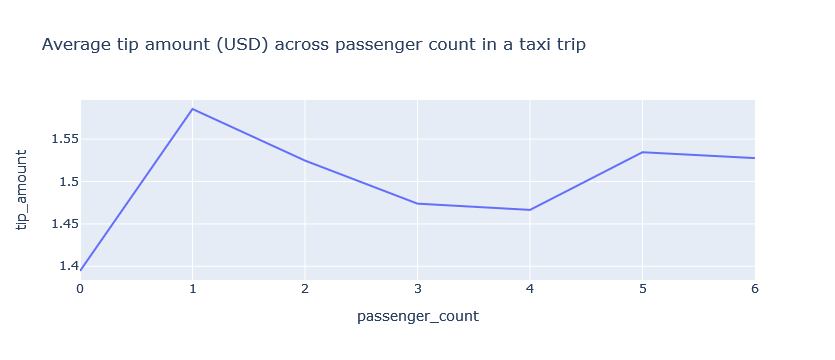

In [772]:
eda_traveltime_boro = nyctrips_meal_rest.groupby(['passenger_count']).agg({'tip_amount': 'mean'}).reset_index()
px.line(eda_traveltime_boro, x='passenger_count', y='tip_amount',
       title='Average tip amount (USD) across passenger count in a taxi trip')

**Summary:**
- Taxi tipping amount varies across restaurants' cuisine types. People going to **Soul Food** restaurants tend to tip the highest on average (USD 3.5), followed by Bangladeshi (USD 2.4) and Ethiopian (USD 2.2) cuisines
- Across the 5 boroughs in New York, people going to restaurants in **Queens** tip their taxi drivers the highest amount on average (USD 3.7), and taxi rides ending in restaurants in Manhattan tend to receive the least tips on average per trip (USD 1.5)
- People tend to tip slightly **higher during dinner time** meals than lunch times (USD 1.6 vs 1.5)
- Tipping amount is maximum for a **single passenger** (USD 1.6) and then decreases linearly as the number of passengers increase till 4 people. After 5 or more passengers, the average tipping amount increases again (USD 1.5), possibly due to the taxi being a bigger car.

## Predictive Model

> Describe how you would set up a predictive model of restaurant cuisine type to be visited by a taxi
rider based on information present in the two datasets

In order to build a model to determine the restaurant cuisine type visited by a taxi rider, we should start by answering the question - **Where in the journey of a taxi ride would this model be utilized?** A model that gives a prediction of the restaurant cuisine at the beginning of the taxi trip is different than a model that predicts the cuisine type after the trip is over. 

**Application of the predictive model**

The former model would be useful for the taxi cab company. For example, at the beginning of the journey, knowing the predicted restaurant cuisine type would help the taxi company tailor the ride experience of the passenger(s). They might offer customized recommendations from the menu, information such as nutrition value, ability to do table reservations, offer discounts, show promotions and display any event information at the restaurant venue. This would enhance the ride experience of the passengers before they reach the restaurant. Furthermore, building such a predictive model would have access to a limited number of input features. The actual values of the trip distance, trip time, total fare, tip amount, exact dropoff coordinates would be unknown during the trip and would have to be *estimated*.

In contrast to this, the latter model which predicts the restaurant cuisine type after the taxi trip is over would be useful to analyze the movement of people from a macro lens. This post facto analysis might uncover food consumption patterns of masses from their movement data. Having the capability of predicting the cuisine type that people consume based on their journeys can inform decisions such opening a new restaurant or meal delivery service in a new region. This can be done by correlating taxi ride patterns between two regions - one where model was trained, and another region where a new restaurant/meal delivery service is to be started.

**Model specification**

For the task, we can build a classification model, specifically a multi-class classification model. Using the historical information present in the NYC taxi trips and the NYC restaurant inspections datasets as the independent `input` variables, the multi-class classification model would be able to predict a value for the dependent `target` variable, `restaurant cuisine type`, for a given set of inputs.

**Predictive Model**: Multi-class Classification (or Multi-label if we want predictions of multiple possible cuisine types. We might be able to uncover insights from cuisine types that are most frequently predicted together)   
**Input**: Features such as taxi trip details (passenger_count, trip_distance, fare_amount, pickup location, pickup time and more. A subset of most important features to be identified via feature importance techniques    
**Target**: Restaurant Cuisine Type (78 classes or cuisine types)  
**Model(s)**: Logistic Regression, Decision Trees, Random Forest, Support Vector Machines, Neural Networks

**Additional data**: Weather, temperature, holidays and events also affect what cuisine people choose to eat. In addition, we can get additional restaurant attributes such as ratings and reviews, price range. Presence of such data may help increase the predictive model's performance. 

**Building and evaluating the predictive model**

1. Data pre-processing: Although minimal pre-processing was done in this notebook (such as removing Null values from restaurant addresses, removing trips where the fare amount was negative), thorough cleaning of input data would be required before it is ready for the model. This involves treating missing values in all columns, outliers in numerical columns like trip distance, fare amount, convert categorical features like pickup_hour to numerical, although some models like Random Forest can handle categorical columns too.  

1. Treating Class Imbalance: Out of 78 cuisine types, only 68 cuisine types have more than 10 taxi trips, and only 34 have more than 100 taxi trips. Although these low number of data points can be improved by acquiring taxi trip data for more days (we only have data for 1 day in this notebook). There would still be some cuisine types that are over-represented in the training data and some that would be under-represented. Possible solutions to this problem are methods such as SMOTE (Synthetic Minority Over-sampling Technique) to create synthetic data samples for under-represented cuisines, or merging similar cuisine types.

1. Data Splitting: Splitting data into training, validation and test sets. Training set would be used to train the model, validation to tune the hyperparameters and test set to evaluate the model performance on unseen data.

1. Training and Hyperparameter tuning: Training would be performed on the training set, and then tuning model's hyperparameters using the validation set. The hyperparameters for different types of models can include the regularization parameter, max depth of tree, learning rate, number of hidden layers, and number of neurons per layer

1. Evaluating the model: Finally, we would evaluate the model's performance on the test set using metrics such as accuracy, precision, recall, and F1 score. These metrics will provide insights into how well the model is predicting the cuisine type based on taxi ride information. Based on the model evaluation results, we can choose the best performing model or create an ensemble of models for the prediction.
